_________________________________________________

# Making Sense of Summer Exercising Data

Over the summer of 2019, the subject started increasing exercise. Data was collected via a variety of devices and published to the social sharing site strava. 

The following is my attempt at cleaning, transforming and understanding this real-time, messy & complicated workout data set sourced from multiple exercise wearable devices. Let's dive in. 

## Part 0. Import Data and Dependent Libraries

The following libraries will be used in this notebook

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import folium

Import our data set ``strava.csv``. 

*Note:* my Jupyter notebook is placed in the same folder as source data file ``strava.csv``, feel free to update the below file path accordingly to suit where you stored the file. 

In [2]:
strava_df = pd.read_csv('strava.csv')

## Part I. Data Cleaning

Step 1: Let's start with making sure that all time fields and position fields in the dataframe are converted to the appropriate format

In [3]:
#convert timestamp column to datetime format
strava_df['timestamp']=pd.to_datetime(strava_df['timestamp'])

# convert position from radian to degrees
strava_df['position_lat_degrees'] = strava_df['position_lat'] * ( 180 / 2**31 )
strava_df['position_long_degrees'] = strava_df['position_long'] * ( 180 / 2**31 )
#strava_df['times']=strava_df['timestamp'].dt.time
#strava_df['month']=strava_df['timestamp'].dt.month

#drop unknown columns
strava_df.drop(columns=['unknown_87','unknown_88','unknown_90'], inplace = True)


The dataframe contains both data file source and timestamp, but both are not the best way to parse the dataset. You can have multiple exercises in a day and you may have one exercise across multiple data file sources. The ideal way is to identify unique exercises.

Step 2: Identify and segment unique exercises within the dataframe using time difference between timestamps

In [4]:
# find the time difference between activity timestamps
strava_df['time_delta'] = strava_df.timestamp.diff()
strava_df.iloc[0, 21] = pd.Timedelta('00:00:00') # fill in for the first value

# assume that if there was a break longer than 30 minutes between a day's exercise
# then these were two exercises 
q = 1
def exercise_number(x):
    global q
    if x < pd.Timedelta('00:30:00'):
        return q    
    else:
        q += 1
        return q
        
strava_df['exercise_id'] = strava_df['time_delta'].apply(lambda x:exercise_number(x))

Step 3: parse out date from timestamp

In [5]:
strava_df['dates']=strava_df['timestamp'].dt.date.astype(str)

In [6]:
strava_df.head()

,Air Power,Cadence,Form Power,Ground Time,Leg Spring Stiffness,Power,Vertical Oscillation,altitude,cadence,datafile,...,heart_rate,position_lat,position_long,speed,timestamp,position_lat_degrees,position_long_degrees,time_delta,exercise_id,dates
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,activities/2675855419.fit.gz,...,68.0,NaN,NaN,0.0,2019-07-08 21:04:03,NaN,NaN,0 days 00:00:00,1,2019-07-08
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,activities/2675855419.fit.gz,...,68.0,NaN,NaN,0.0,2019-07-08 21:04:04,NaN,NaN,0 days 00:00:01,1,2019-07-08
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54.0,activities/2675855419.fit.gz,...,71.0,NaN,NaN,1316.0,2019-07-08 21:04:07,NaN,NaN,0 days 00:00:03,1,2019-07-08
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3747.0,77.0,activities/2675855419.fit.gz,...,77.0,504432050.0,-999063637.0,1866.0,2019-07-08 21:04:14,42.281006,-83.740547,0 days 00:00:07,1,2019-07-08
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3798.0,77.0,activities/2675855419.fit.gz,...,80.0,504432492.0,-999064534.0,1894.0,2019-07-08 21:04:15,42.281043,-83.740622,0 days 00:00:01,1,2019-07-08


Step 4: Create a summary dataframe with basic aggregated values grouped by each unique exercise

In [8]:
summary_df = strava_df.groupby(['exercise_id']).agg({'timestamp':['min','max','count'],
                                                         'dates':['min','max','count'],
                                                         'enhanced_speed':['min','max','mean'], 
                                                         #'speed':['min','max','mean'],  
                                                         'heart_rate':['min','max','mean'],
                                                         'distance':['min','max']
                                                        })

# reduce the multi-level column names to one level, rename columns accordingly
summary_df.columns = ["_".join(x) for x in summary_df.columns.ravel()]
summary_df

<ipython-input-8-ec63b564b939>:10: FutureWarning: Index.ravel returning ndarray is deprecated; in a future version this will return a view on self.
  summary_df.columns = ["_".join(x) for x in summary_df.columns.ravel()]


,timestamp_min,timestamp_max,timestamp_count,dates_min,dates_max,dates_count,enhanced_speed_min,enhanced_speed_max,enhanced_speed_mean,heart_rate_min,heart_rate_max,heart_rate_mean,distance_min,distance_max
exercise_id,,,,,,,,,,,,,,
1,2019-07-08 21:04:03,2019-07-08 21:23:55,246,2019-07-08,2019-07-08,246,0.000,3.144,2.088154,68.0,137.0,118.337398,0.00,2617.46
2,2019-07-10 23:18:00,2019-07-10 23:37:20,178,2019-07-10,2019-07-10,178,0.000,3.210,2.581567,71.0,143.0,130.123596,0.00,849.94
3,2019-07-12 21:27:11,2019-07-12 22:30:17,911,2019-07-12,2019-07-12,911,1.325,3.480,1.966212,73.0,126.0,117.687157,1.82,7473.66
4,2019-07-14 17:20:28,2019-07-14 18:38:22,1141,2019-07-14,2019-07-14,1141,1.129,2.519,1.785065,97.0,125.0,110.975460,1.27,8472.28
5,2019-07-14 20:45:07,2019-07-14 21:04:51,299,2019-07-14,2019-07-14,299,0.000,3.863,2.078495,86.0,132.0,123.819398,0.73,2613.32
6,2019-07-16 21:10:40,2019-07-16 21:29:10,170,2019-07-16,2019-07-16,170,0.000,4.432,2.380412,71.0,137.0,118.858824,0.00,1704.76
7,2019-07-17 23:17:06,2019-07-18 00:42:16,831,2019-07-17,2019-07-18,831,0.000,2.799,1.924082,79.0,155.0,128.251504,0.00,5093.44
8,2019-07-18 20:47:54,2019-07-18 21:37:03,640,2019-07-18,2019-07-18,640,0.000,2.790,1.828019,82.0,131.0,109.853125,1.15,5261.57
9,2019-07-20 14:56:40,2019-07-20 15:56:14,1002,2019-07-20,2019-07-20,1002,0.980,2.286,1.763113,79.0,116.0,107.839321,1.47,6445.71


Step 5: Use the aggregated values at exercise level to calculate a few more metrics and classify each exercise

In [8]:
# 1) calculate exercise duration in minutes
summary_df['duration'] = (summary_df['timestamp_max']- summary_df['timestamp_min']
                         ).apply(lambda x: x.seconds/60 ) #convert timedelta to minutes in float
# optional: sanity check math with summary_df['duration_raw'] = summary_df['timestamp_max']- summary_df['timestamp_min']


In [9]:
# 2) bucket the duration as long or short
def long_short_duration(x):
    if x > 45: # workout over 45 minutes are generally considered long
        return 'Long'
    else:
        return 'Short'
    
summary_df['long/short'] = summary_df['duration'].apply(lambda x:long_short_duration(x))

In [10]:
# 3) classify each exercise as Bike or Run based on average speed 
# https://www.bbc.co.uk/bitesize/guides/zq4mfcw/revision/1
def exercise_type(mean_speed):
    if mean_speed > 5:
        return 'Bike'
    else:
        return 'Run'

summary_df['exercise_type'] = summary_df['enhanced_speed_mean'].apply(lambda x:exercise_type(x))

summary_df = summary_df.reset_index()
summary_df.head()

,exercise_id,timestamp_min,timestamp_max,timestamp_count,dates_min,dates_max,dates_count,enhanced_speed_min,enhanced_speed_max,enhanced_speed_mean,heart_rate_min,heart_rate_max,heart_rate_mean,distance_min,distance_max,duration,long/short,exercise_type
0,1,2019-07-08 21:04:03,2019-07-08 21:23:55,246,2019-07-08,2019-07-08,246,0.000,3.144,2.088154,68.0,137.0,118.337398,0.00,2617.46,19.866667,Short,Run
1,2,2019-07-10 23:18:00,2019-07-10 23:37:20,178,2019-07-10,2019-07-10,178,0.000,3.210,2.581567,71.0,143.0,130.123596,0.00,849.94,19.333333,Short,Run
2,3,2019-07-12 21:27:11,2019-07-12 22:30:17,911,2019-07-12,2019-07-12,911,1.325,3.480,1.966212,73.0,126.0,117.687157,1.82,7473.66,63.100000,Long,Run
3,4,2019-07-14 17:20:28,2019-07-14 18:38:22,1141,2019-07-14,2019-07-14,1141,1.129,2.519,1.785065,97.0,125.0,110.975460,1.27,8472.28,77.900000,Long,Run
4,5,2019-07-14 20:45:07,2019-07-14 21:04:51,299,2019-07-14,2019-07-14,299,0.000,3.863,2.078495,86.0,132.0,123.819398,0.73,2613.32,19.733333,Short,Run


Step 6: Create an unique name for each exercise

In [11]:
# use start date, exercise number and type to create an unique name for each exercise
summary_df['name'] = summary_df['dates_min']+' '+'Exercise '+summary_df['exercise_id'].astype(str)+' '+summary_df['exercise_type']

Step 7: Enhance the strava df with aggregated metrics from the summary_df

In [12]:
merge_name_df = summary_df[['name',
                            'exercise_id','exercise_type',
                            'timestamp_min','timestamp_max',
                            'duration','long/short',
                            'enhanced_speed_mean',
                            'heart_rate_mean',
                            'distance_max',
                            ]]

# enhance the strava df with the exercise uniquenames and type, and duration
merge_name_df
strava_df = strava_df.merge(merge_name_df,how = 'left', on = 'exercise_id')
strava_df.head()

,Air Power,Cadence,Form Power,Ground Time,Leg Spring Stiffness,Power,Vertical Oscillation,altitude,cadence,datafile,...,dates,name,exercise_type,timestamp_min,timestamp_max,duration,long/short,enhanced_speed_mean,heart_rate_mean,distance_max
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,activities/2675855419.fit.gz,...,2019-07-08,2019-07-08 Exercise 1 Run,Run,2019-07-08 21:04:03,2019-07-08 21:23:55,19.866667,Short,2.088154,118.337398,2617.46
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,activities/2675855419.fit.gz,...,2019-07-08,2019-07-08 Exercise 1 Run,Run,2019-07-08 21:04:03,2019-07-08 21:23:55,19.866667,Short,2.088154,118.337398,2617.46
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54.0,activities/2675855419.fit.gz,...,2019-07-08,2019-07-08 Exercise 1 Run,Run,2019-07-08 21:04:03,2019-07-08 21:23:55,19.866667,Short,2.088154,118.337398,2617.46
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3747.0,77.0,activities/2675855419.fit.gz,...,2019-07-08,2019-07-08 Exercise 1 Run,Run,2019-07-08 21:04:03,2019-07-08 21:23:55,19.866667,Short,2.088154,118.337398,2617.46
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3798.0,77.0,activities/2675855419.fit.gz,...,2019-07-08,2019-07-08 Exercise 1 Run,Run,2019-07-08 21:04:03,2019-07-08 21:23:55,19.866667,Short,2.088154,118.337398,2617.46


# Part II. Data Visualization and Findings

## A. Metrics Correlation Analysis


> Are there any correlation between the health and intensity indicator metrics in the Strava dataset, such as heart rate, speed, altitude, power, and form power?

There are lots of physical metrics captured within the Strava dataframe. I am especially curious in exploring health and intensity indicator metrics in the Strava dataset, such as heart rate, speed, altitude, power, form power and air power. 

Scatter plots are a good way to visualize data point clusters, while identifying relational and directional patterns between metrics. Scatterplot matrics (or sploms) expand upon the strength of a scatter plot alone and provide a birds-eye view of coorelation patterns across multiple metrics at once. This makes splom an excellent choice for this question. 

The Seaborn library is the best for splom. It is very simple to create sploms with the pairplot function, often requring a single line of code. One can pass a dataframe with numerical variables, and get a nice scatter plot matrix. 

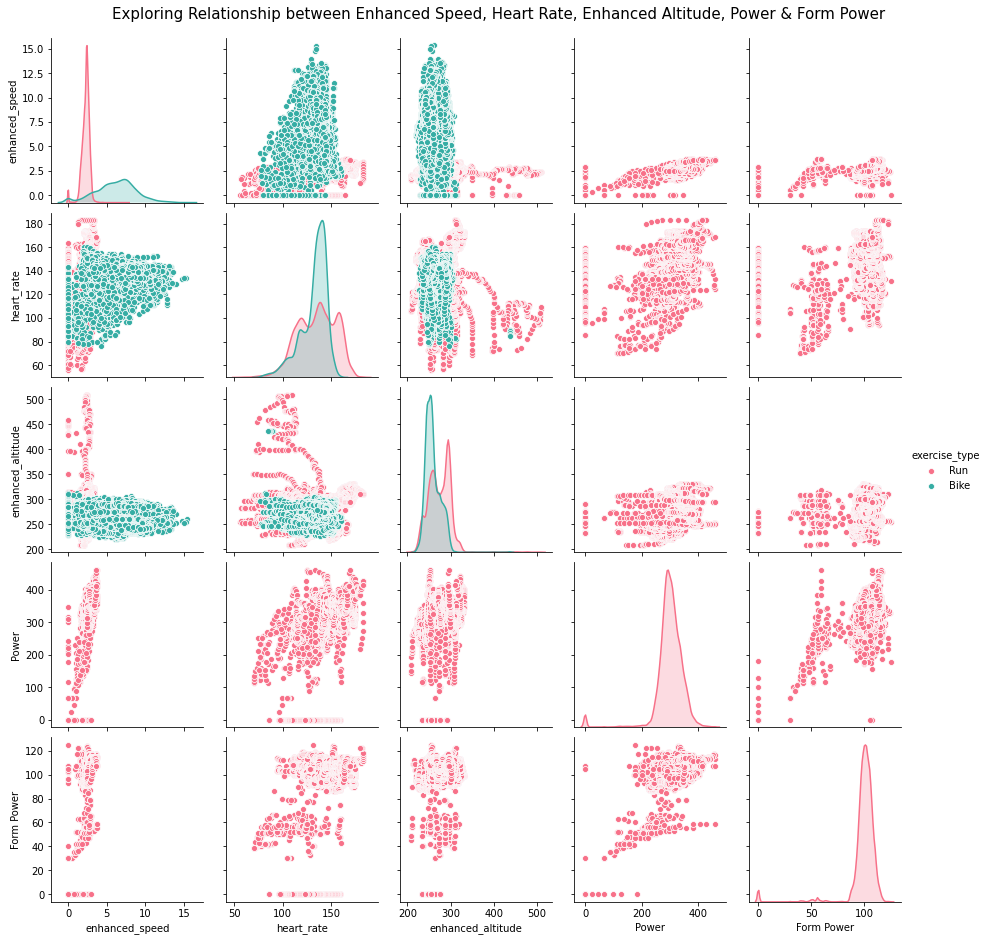

In [13]:
# reduce the strava df to just our interested metrics
SPLOM_df = strava_df[['enhanced_speed', 
                      'heart_rate',
                      'enhanced_altitude',
                      'Power',
                      'Form Power',
                      'exercise_type']]

def SPLOM(df,hue_column,title):
    sns.pairplot(df, 
                 hue=hue_column, 
                 palette='husl'); #use a more transparent color palette to better see data overlaps 
    
    plt.suptitle(title, 
                 y=1.03, # spacing between title and plot
                 size = 15) # font size
    
SPLOM(SPLOM_df, 
      'exercise_type', 
      'Exploring Relationship between Enhanced Speed, Heart Rate, Enhanced Altitude, Power & Form Power')

#### Insights:
   - Enhanced speed seems to have a relatively positive coorelation with heart rate during both running and biking exercises. This makes sense, as one run faster or speed up during cycling, more energy is required. Heart rate would likely increase to increase blood flood and oxygen delivery throughout the body. Enhanced speed also seems to have a weak positive coorelation with power and form power. Unfortuantely, there's only data for running. It's hard to tell if the correlation would be more pronouced in higher intensity cardio exercises such as biking. Speed and altitude does not seem to have a clear coorelation based on the run and bike data given. 
   
   - Other than its preceived coorelation with enhanced speed mentioned above, heart rate also seems to have a relatively positive coorelation with power based on running data alone. Its coorelation with form power is less formed by the data, but the trend seems positive overall. Both of these correlations make sense. Power in the physics definition is work over time. Increase work output requires more energy and therefore likely coorelates with increased heart rate. Heart rate and altitude does not seem to have a clear coorelation based on the run and bike data given. 
   
   - Beyond the above mentioned analysis on enhanced altitude, it also does not seem to have a clear coorelation with power or form power based on the run data available.  
   
   - Last but not least, power seeems to positively coorelate with form power. This makes sense as well. As these metrics came from Stryd and Stryd calculates form power as an additional component of running power, weight-dependent and relating to vertical oscillation and cadence. Source: https://support.stryd.com/hc/en-us/articles/360038728714-What-is-Stryd-Form-Power-


## B. Next steps: Narrowing in on Heart Rate & Enhanced Speed


In addition to the insights above, Splom analysis also shows us there are a good amount of heart rate and enhanced speed available to compare across the Bike and Cycling exercises. That sounds interesting. Let's dive into that a little further. 

> How does Prof. Brooks heart rate activities compare during running vs. biking?

To compare heart rate data between running and biking, we are going to use a boxplot. Boxplots are great at representing the range of data present, where the majority of data points concentrate, identifying the median and even outliers. Distribution is a big part of what we are after looking at heart rate activites across exercise types. Therefore, boxplots' ability to quickly call out these important aspects of the data makes it a fitting choice. 

Before we start ploting, let's do some quick checks on how many exercises we have for each category to understand our sample size:

In [14]:
summary_df.groupby('exercise_type').agg({'exercise_id':'count'})

,exercise_id
exercise_type,
Bike,11
Run,42


We have ample runs in our dataset, but the sample size for cycling is a little small (<25). Something to keep in the back of our mind as we continue the analysis. 

On to boxplots, but first a little bit more data cleaning

In [15]:
# reduce strava_df to heart rate stats columns
HR_df = strava_df[['name','heart_rate','exercise_type','duration']]
HR_df = HR_df.dropna() #drop NaN values

We'll use the plotly.express module library to make the plot. In my personal experience so far, this library is terse in code but robust in output. In someways, it combines the convinence of matplotlib and the design of more client-friendly libraries like Altairs. I also find the in-built tooltip and hover windows options really helpful. These can serve as dynamic call-outs without crowding the visualization. 

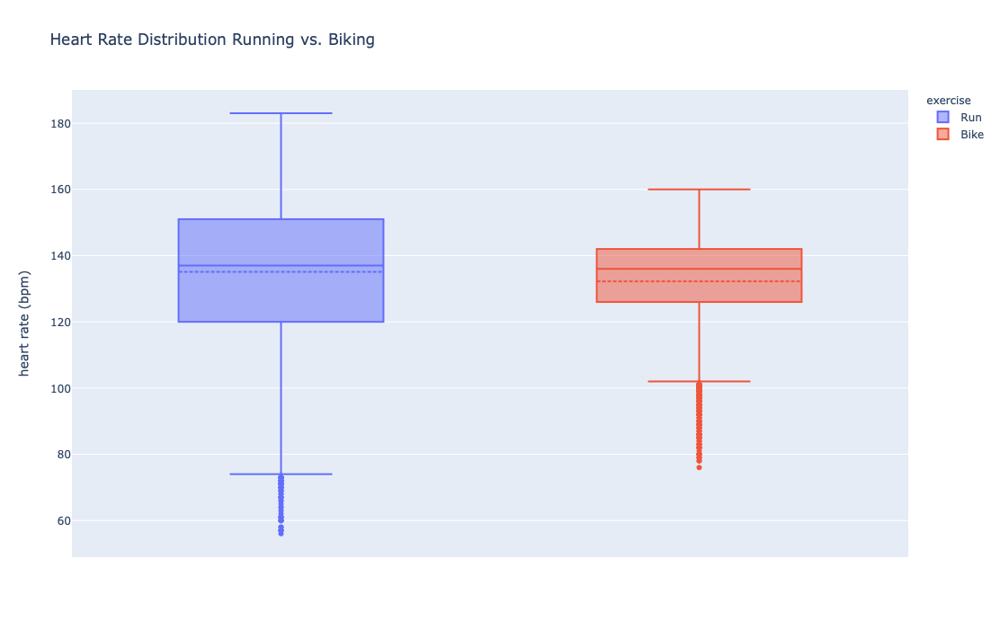

In [16]:
box = px.box(HR_df,  
             x='exercise_type',
             y='heart_rate', 
             color='exercise_type',  #use color to help users differentiate between the two exercise quicker
             labels={'heart_rate': 'heart rate (bpm)', #update the labels to include units and without '_'
                     'exercise_type': 'exercise'
                 },
             title = 'Heart Rate Distribution Running vs. Biking',
             hover_data= ['name'],
             height = 700) #increase the height so the outliers are less crowded

# show mean
box.update_traces(boxmean=True)

# hide the redundant x-axis labels
box.update_layout(xaxis={'visible': False, 
                         'showticklabels': False})

box.show()


Using the above boxplot, we can compare the range and distribution of the heart rate for running and biking.

#### Insights:


   - There is a greater variability for heart rate during running than biking. 
        - Within the limited data we have in the Strava file, running heart rate ranges from 56 to 183 bpm, while cycling heart rate ranges from 76 to 160 bpm. Running also have a larger IQR than biking as seen by the length of the boxes, which means that running data within 25% - 75% quantiles varies more than their counter part in biking. 
        
        - Let's make some sense out of this. The average resting heart rest is about 60 bpm. Right at the minimum values of running heart rates. When people run there's usually a gradual warm up, and heart rate will adjust accordingly to keep pace. That tracks with what we are seeing for run boxplot. One can slow down or run faster, there's more flexibity and therefore variability. Cycling is different, there is a minimum level of effort that needs to be continutously exerted in order to stay in motion and on the bike. There's usually a faster ramp up to that threshold and a more consistent hold after the ramp up, until the end of the exercise. This would explain the more concentrated data points that we see as well.
        
        
        
   - Running than biking have close mean and medians - clustered around 134 bpm
        - Both run and biking data have close mean and medians, indicating they are both relatively symmetrical in distribution.
        
        - Their mean and medians heart rate are also close to one another. Suggesting that these two exercises put relatively similar stress on the Professor's heart during work out on average. 
   
*Note:* we are at a disadvantage with a small sample size of biking exercises data collected with the Strava dataset, the range, median and mean for biking heart rate may change if we have more samples. 

### What's Next? A Need for Speed

Now that we've looked at heart rate differences between the exercises, let's spend some time with another metric that also had a decent amount of data for both exercise groups - Enhanced Speed, in m/s - and see what insights we can gain from looking into its data. 

You might recall that the average of this particular metric per exercise was used earlier to determine whether an exercise would be classified as a running event or biking event. In this next step, I'd like to plot the bird-eye view of all exercises sessions' with line plots of speed over time. We should be able to tell easily based on speed distribution if an exercise is a run or cycling session. 

It's quite a large plot, I often get the browser warning of its significant memory consuption, but it's worth it. This was one of first plots I did when I started cleaning the dateframe, and I find myself coming back to this plot over and over again as I gained more insight into how the data could be organized. I have managed to find new insights almost every time. Both at a macro level - behavioral patterns across exercises types, and down to the granular patterns of breaks. Been able to see all the exercises visually really helps connect the dots. Some of the questions I wanted to explore are listed below:


> Is speedy maintained for longer sessions compared to shorter within the same exercise? 

> Are there interesting behavioral or time patterns that jump out and worth exploring further?

So let's get started, first we are going to define the data pieces that we are interested in and create a more concise dataframe

In [17]:
speed_df = strava_df[['name','timestamp','enhanced_speed',
                      'duration','long/short','distance',
                      'enhanced_speed_mean','heart_rate_mean']]

I am using Plotly Express library again to produce the visualization, for its code conciseness and wide range of customization options to produce high-quality charts. 

To plot speed over time, I chose line chart. Line charts are a good visualization technique to look at continuous trends. We are ploting speed over time per unique exercise. It is a reason to assume that the activity recorded within the exercise would be mostly continuous, with possible breaks under 30 minutes. Recall earlier we use 30 minutes as our cut off to define separate exercises or Prof.Brooks taking a water break in between reaps of otherwise continuous exercise. 

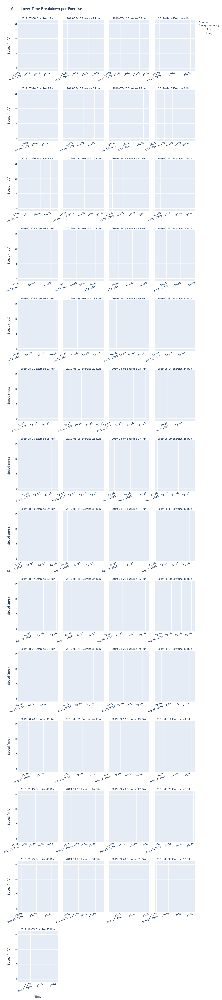

In [18]:
line = px.line(speed_df, 
               x='timestamp', 
               y='enhanced_speed',
               color = 'long/short', # color differentiate the long and short exercises 
               labels={'timestamp':'Time', # labels change how the column names appear in the visualization - add units, line breaks, etc
                       'name':'ID',
                       'enhanced_speed':'Speed (m/s)',
                       'duration':'Duration (min)',
                       'distance':'Distance(m)',
                       'enhanced_speed_mean':'Avg Speed (m/s)',
                       'heart_rate_mean':'Avg Heart Rate (bpm)',
                       'long/short':'Duration<br>( long >45 min )'}, # add a quick note to remind readers the definition of long vs. short
               title = 'Speed over Time Breakdown per Exercise',
               facet_col = 'name',
               facet_col_wrap=4, #define col limit 
               facet_row_spacing=0.02, #adjust padding between rows
               facet_col_spacing=0.03, #adjust padding between cols
               # customize the hover pop up to show supplementary data points that will help identify potential trends and relationships
               hover_data={'long/short':False, # remove from hover data
                           'name':True, # pass as is
                           'timestamp':True, 
                           'enhanced_speed':':.2f', # customize formatting to two decimals
                           'duration':':.2f', 
                           'distance':':.2f',
                           'enhanced_speed_mean':':.2f',
                           'heart_rate_mean':':.2f',
                            },
               height=5000)

# update each xaxes to be independent, and show tick labels
line.update_xaxes(matches=None, 
                  showticklabels=True,
                  tickangle=-20) # rotate the ticks to allow better visibility and less crowdedness

# clean up the default subplot labels
line.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
line.show()

That's a monster chart - with lots of nuggets of information that we can use! Below are some of my insights for the questions listed.

### Insights for Q1:

   - Prof Brooks' speed is surprisingly unaffected by longer sessions from what we can see on the line charts. He seemed to be able to maintain speed regardless the duration within the same exercise. This is speaks to endurance and resilience, considering some of the longer exercises were over an hour.


### Insights for Q2:

   - Professor Brooks seems to be an night owl when it comes to exercising, the majority of exercises start betweeen 8pm to 11pm, with a few start times deep into the night (ex. the latest run on 8/21 started after 3am, following a prior run that occured at 1am)
   
   
   - Professor switched from running completely to cycling from September onward. August 31st marked the last run in the Strava dataset. The Professor was able to complete 20 run in July, 22 runs in August, and 8 bike rides in September. 
   
   
   - Notably, there are 3 overnight runs longer than 45 minutes, they are:
        - 7/17 ex 7 Run 61 minutes
        - 7/24 ex 14 Run 64 minutes
        - 8/7 ex 27 Run 76 minutes


These runs in particular peaked my interest, let's see if we can go deeper in the next section. 

## C. Location, Location, Location
##### Where can one go running after midnight around A2 and other interesting geomapping questions


Selfishly, as an ex-A2 townie (don't worry, my phone area code will always be 734), I can't help but want to look deeper into the routes of Prof Brook's runs and bikes. Has he ever run by my old high school (previously a Salamander swamp, Go Eagles!)? Does he visit my favorite trails along the huron river? What about the Arb where everyone and their mother took their graduation photos? 

After spotting some of the behavioral trends from the speed analysis above, I have more reason to map out his exercises over the summer and dig deeper on follow-up questions listed below:

> Where does Prof. Brooks go to exercise? Are there general favorite routes/stops/locations Prof Brooks likes to visit?

> Where does he go on these late night runs?


In [19]:
# narrow the strava df to relevant columns
routes_df = strava_df[['exercise_id','name',
                       'timestamp_min','timestamp_max',
                       'position_lat_degrees','position_long_degrees',
                       'exercise_type','duration','enhanced_speed_mean',
                        'heart_rate_mean','distance_max']] 

#routes_df.isnull().sum() #192 nulls on lat and longitude 
#routes_df.head()

I will be using the folium library for this exercise. I find it the easiest to use out of all mapping options across different libraries. The OpenStreetMaps background is also excellent to identify Ann Arbor landmarks and roads that brings back memories. 

In [20]:
def map(show_routes):
    m=folium.Map(location=[42.349,-83.855], zoom_start=10)


    for exercise_name, exercise_grp in routes_df.groupby('name'):
        # prepare exercise specific df
        # fill NaN lat and longitude values within the exercise
        # forward first, then backward
        exercise_grp = exercise_grp.ffill().bfill().reset_index()

        # initiate the folium feature group/layer
        feature_group = folium.FeatureGroup(exercise_name,show=show_routes) 
        # default is to show all the layers
        # to quickly unselect all routes, update show to False and use the layer drop down to selectively view individual exercise 

        # set up the information for the each exercise's popup 
        info = '{}<br><br>Start Time: {}<br>End Time: {}<br>Duration: {:.2f} min<br><br>Total Distance: {:.2f} m<br>Avg Speed: {:.2f} m/s<br>Avg Heart Rate: {:.2f} bpm'.format(
                                                                                                                 exercise_name,
                                                                                                                 exercise_grp['timestamp_min'][0], #start time
                                                                                                                 exercise_grp['timestamp_max'][0], #end time
                                                                                                                 exercise_grp['duration'][0],
                                                                                                                 exercise_grp['distance_max'][0], #total distance
                                                                                                                 exercise_grp['enhanced_speed_mean'][0], 
                                                                                                                 exercise_grp['heart_rate_mean'][0])
        # define line layers, color of lines differ based on exercise type
        # Folium's Polyline configuration only accepts color codes for color, so we'll need to use an IF statement
        if exercise_grp['exercise_type'][0] == 'Run': 
            folium.vector_layers.PolyLine(locations=zip(exercise_grp['position_lat_degrees'],
                                                    exercise_grp['position_long_degrees']),
                                         # format the pop up to show the below stats for each exercise
                                         popup=folium.Popup(html= info,
                                                            max_width=450
                                                           ),
                                         tooltip=exercise_name, # show exercise name in quick tooltip
                                         color='blue', #blue for running
                                         weight=4 #line weight
                                        ).add_to(feature_group)
        else: # exercise type : bike
            folium.vector_layers.PolyLine(locations=zip(exercise_grp['position_lat_degrees'],
                                                    exercise_grp['position_long_degrees']),
                                         # format the pop up to show the below stats for each exercise
                                         popup=folium.Popup(html= info,
                                                            max_width=450
                                                           ),
                                         tooltip=exercise_name, # show exercise name in quick tooltip
                                         color='red', #red for biking
                                         weight=4 #line weight
                                        ).add_to(feature_group)

        # add feature group to map
        feature_group.add_to(m)

    # add the layer control button so users can select, unselected exercises to display on the map    
    folium.LayerControl().add_to(m)    


    display(m)

### Map with all Routes Selected

In [21]:
map(show_routes=True)

### Insights Q1 :

  - Professor's exercise tend to concentrate around Ann Arbor and it's immediate neighboring towns. This makes sense, it is where he lives and works!
      - Bike routes tend to passby the the more scenic areas of Ann Arbor or major roads. For example, along the Huron River, Birds Hill Nature Area, Ann Arbor Golf. This is understandable as these are usually areas with dedicated bike routes. The farthest Prof rode away from A2 was to Dexter. 
      - A LOT of runs through Forthsythe Middle School. Equally as frequent Miller Street, Catherine and North State Street in Downtown Ann Arbor. Forest hill cemetry was also popular.
      - One notably exception occurred on August 17, where he completed a 30 minute run around noon near Brill Lake outside of Jackson
      - Equally odd, an outlier lat and long for Rochester hills was included in the July 16th Run, making it seem that Professor flew straight from A2 to there.
      
      
  
  - There are a few notably most popular starting and ending points 
       - E. Washington Street and S. State Street 
           
           Either Prof.Brooks loves to run and bike to Buffalo Wild Wings, or loves NorthQuad
           (scratching my head on other frequented places around that corner of the town)
          
       - Mixwood St. 
          
          Likely his home base!
          

### Map to Play With!

The map above shows all routes. It's useful to see where routes tend to concentrate, not so good for drill down analysis on individual exercise. 

The map below, however, is a more interactive map that allows you to chose which exercise(s) you would like to see via the layer button in the top right corner of the map. This is a sandbox for you to explore some more. 

I used this map to dig a little deeper into the routes the Professor took on those three overnight runs mention from the last section. My insights are listed below. 

### Insights Q2:
        
Midnight runs:

1) 7/17 ex 7 Run 61 minutes
   
        - Started at Mixwood St. , down Miller, down Packard, many of loops around the Ferry Field in front of the IM building
        
2) 7/24 ex 14 Run 64 minutes
   
        - Started at Mixwood St., out the neighborhood, down North Main and through Bandemer Park (where I took my grad photos!), down the board walk, and curiously at Pontiac and Argo seems like the wearables failed to keep up and had to restart. I initially thought this was a break from the Speed vs. Time line graph above, however, looking at the route map, it's more likely that the device restarted since next lat. and long. place Professor on his way home. Nice, couldn't have completed the picture on this one without both of these visualizations. 
        
3) 8/7 ex 27 Run 76 minutes

        - Almost the exact route 7/17. Started at Mixwood St., down Miller, down Packard, many of loops around the Ferry Field in front of the IM building. Only two data points so far, but I have an inkling that this could be an tried and true route. As we reach the end of this exercise, this would be a great topic to continue to explore in the future. 

In [22]:
map(show_routes=False)

Feel to checked out other route patterns further using this map! 

> **Tip:** Hover over each route for a tooltip that will help to quickly identify the exercise date, type and the exercise ID. Click on each route for a pop up that reveals more information for the selected exercise on start and end time, duration of exercise, total distance, average speed and average heart rate.

# Dependencies

* Python 3.5+
* Pandas
* Plotly 4.12.0
* Jupyter notebook 
    
    notebook>=5.3, ipywidgets>=7.2
* JupyterLab 
    
    ipywidgets>=7.5, [Node.js](https://nodejs.org/en/), jupyter labextension jupyterlab-plotly@4.12.0




